## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [1]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from moviepy.editor import VideoFileClip
from IPython.display import HTML

# First, I'll compute the camera calibration using chessboard images

In [2]:
def undistort(img, mtx, dist):
  return cv2.undistort(img, mtx, dist, None, mtx)

In [3]:
def read_images(dir_name, mtx=None, dist=None):
  files = os.listdir(dir_name)
  images = []
  for file in files:
    img = plt.imread('{}/{}'.format(dir_name, file))
    if mtx is not None and dist is not None:
      img = undistort(img, mtx, dist)
    images.append(img)
  # end for
  return images
# end def

In [4]:
chessboard_images = read_images('camera_cal')

In [5]:
def visualize_many_images(images, ncols=4):
  N = len(images)
  nrows = np.rint(N / ncols).astype(np.int32)
  plt.figure(figsize=(20,20))
  for i,img in enumerate(images):
    plt.subplot(nrows, ncols, i+1)
    plt.imshow(img)
    plt.title('{}'.format(i))
  # end for
# end def

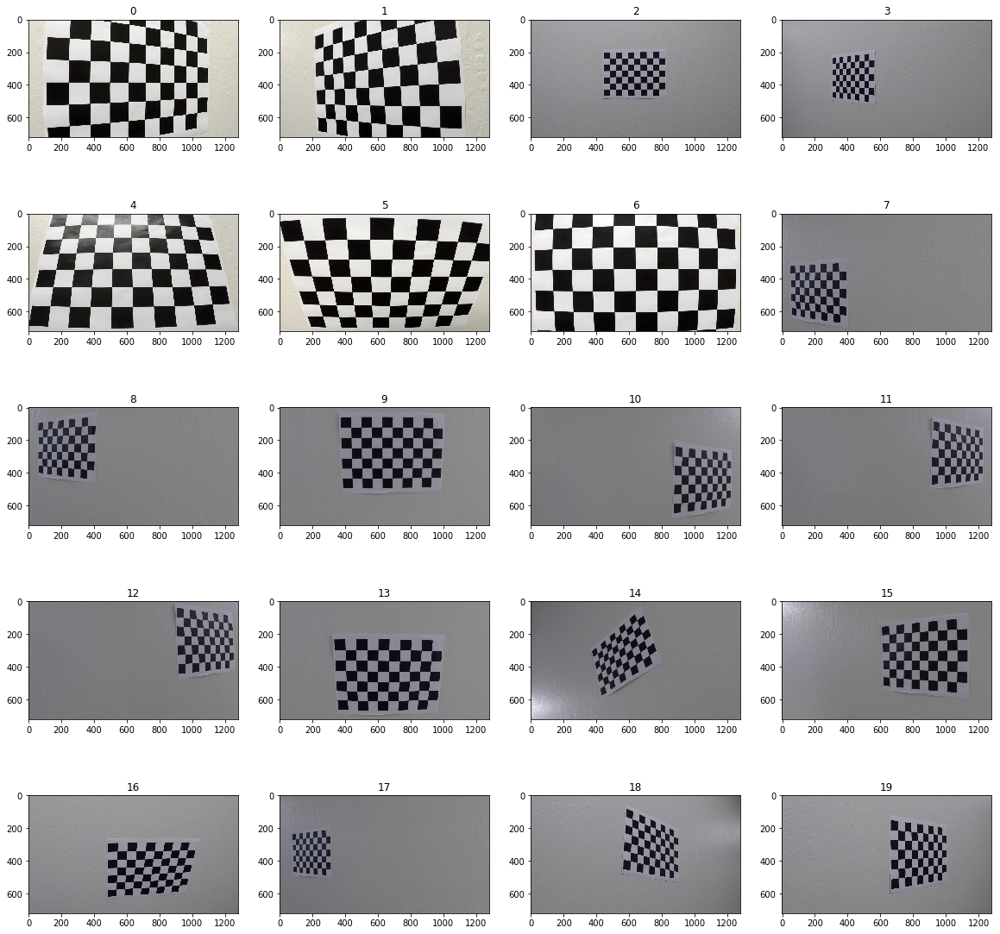

In [6]:
visualize_many_images(chessboard_images)

In [7]:
# this codecell obtains the mapping between observed image points to the real object points
def calibrate_camera(images, nx=9, ny=6):
  # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
  objp = np.zeros((nx*ny,3), np.float32)
  objp[:,:2] = np.mgrid[:nx, :ny].T.reshape(-1,2)

  # Arrays to store object points and image points from all the images.
  objpoints = [] # 3d points in real world space
  imgpoints = [] # 2d points in image plane.

  for img in images:
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    # If found, draw corners
    if ret:
      # Draw and display the corners
      objpoints.append(objp)
      imgpoints.append(corners)
    # end if
  # end for

  # get mtx and dist to undistort images
  ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, (1280, 720), None, None)
  return mtx, dist
# end def

mtx, dist = calibrate_camera(chessboard_images)

In [8]:
def visualize(idx, *imgs):
  plt.figure(figsize=(20,20))
  N = len(imgs)
  for i, (img, text, cmap) in enumerate(imgs):
    plt.subplot(1, N, i+1)
    plt.imshow(img, cmap=cmap)
    plt.title('{}. {}'.format(idx, text), fontsize=16)
  # end for
# end def

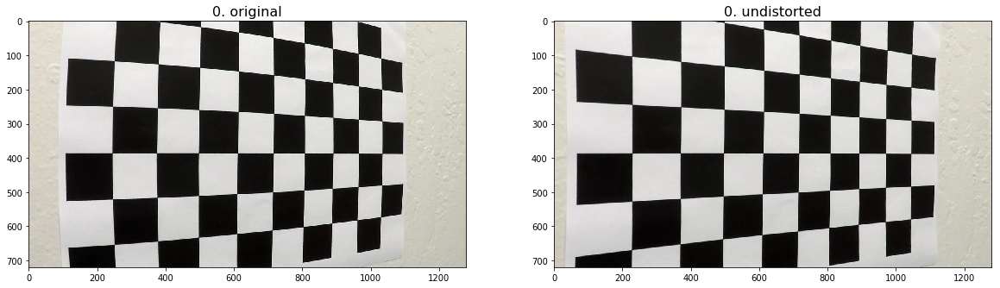

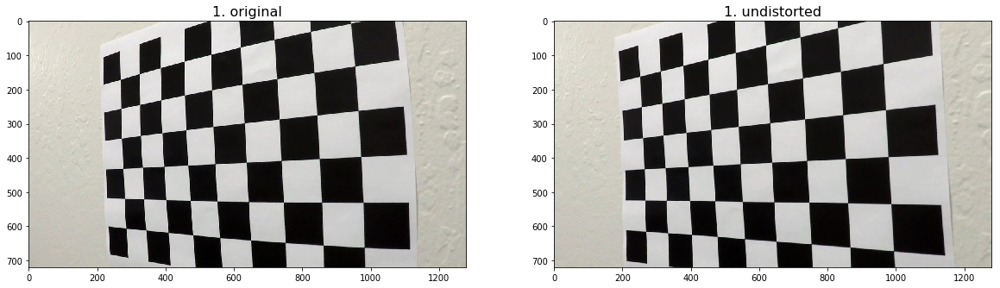

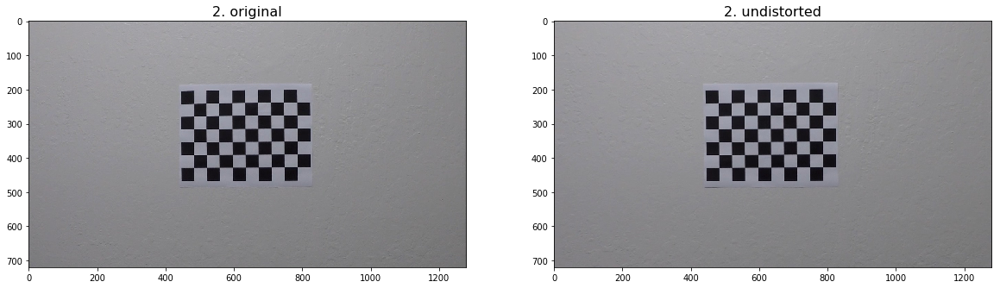

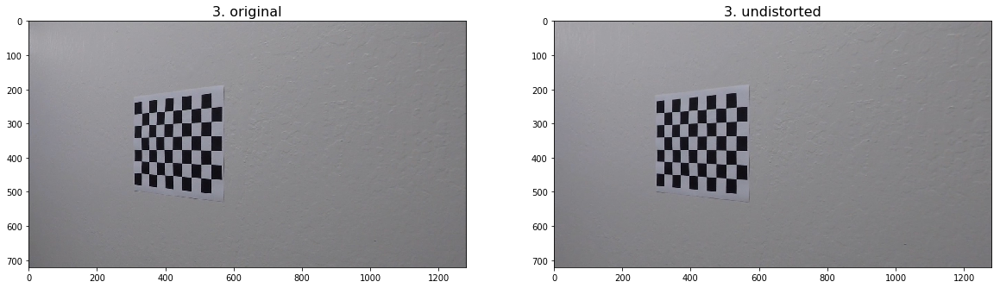

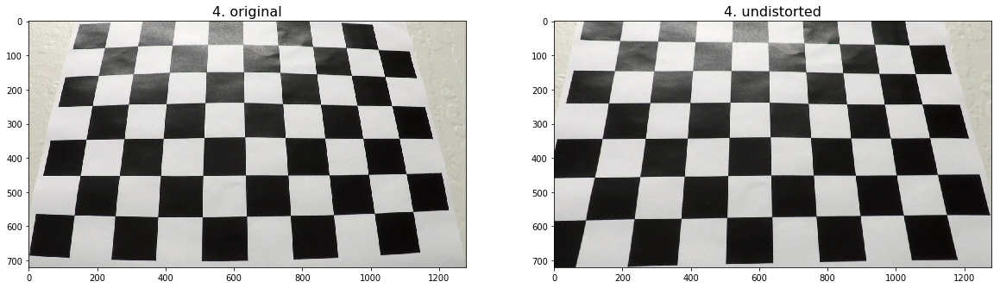

...

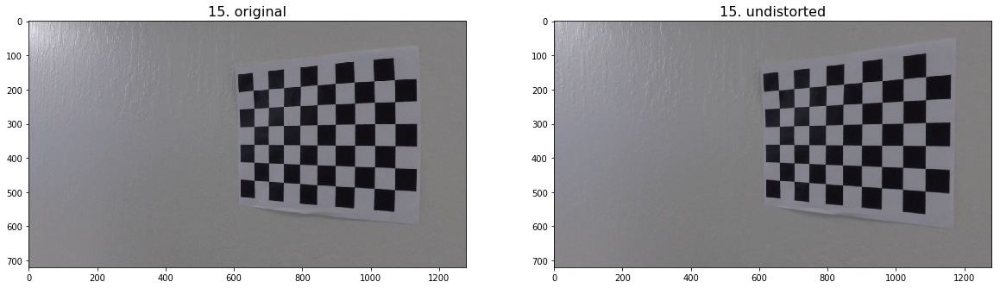

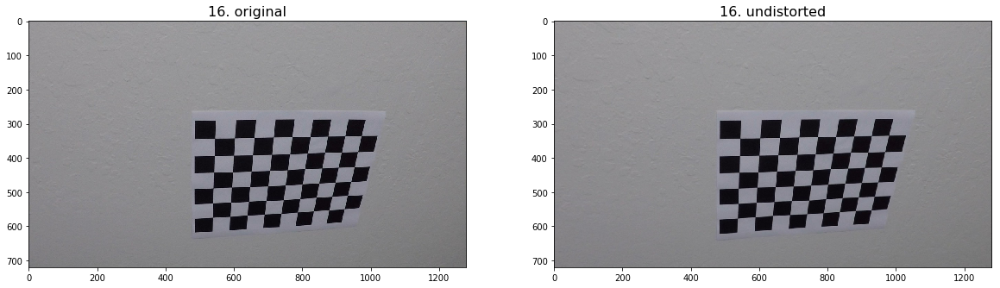

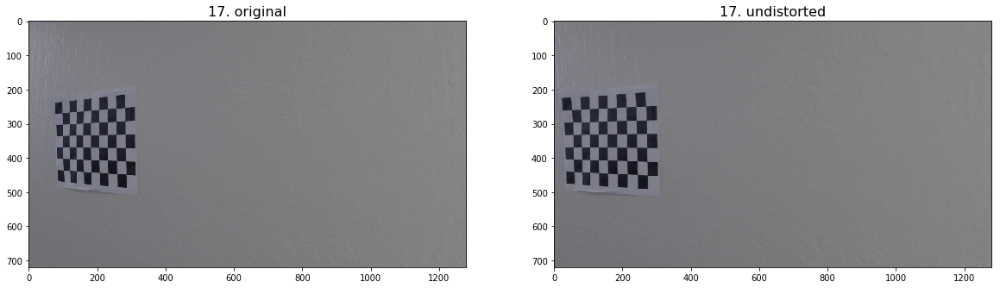

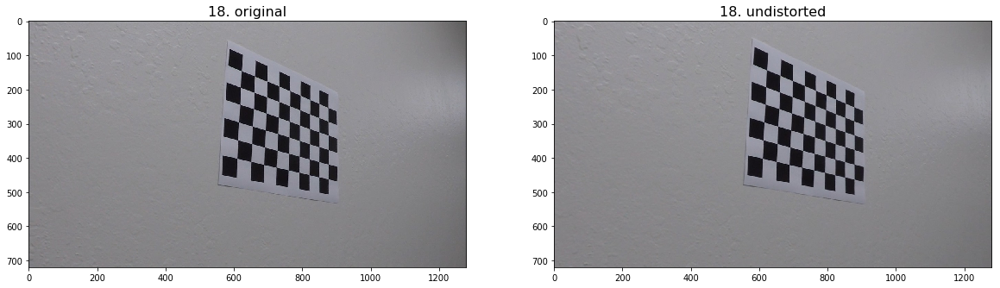

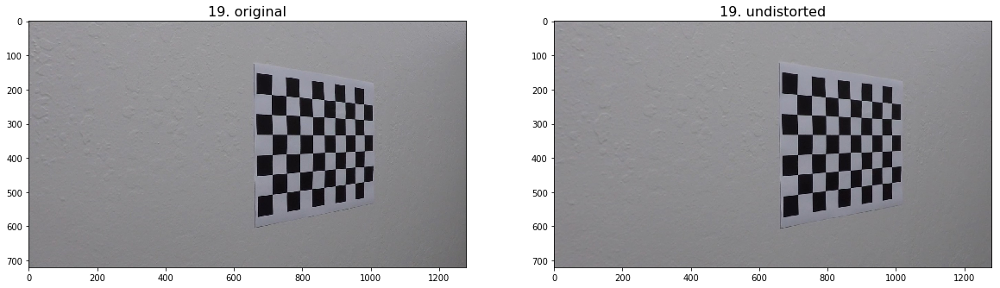

In [9]:
# show the undistorted chessboards
for i, img in enumerate(chessboard_images):
  undistorted = undistort(img, mtx, dist)
  visualize(i, (img, 'original', None), (undistorted, 'undistorted', None))

In [10]:
test_images = read_images('test_images', mtx=mtx, dist=dist)

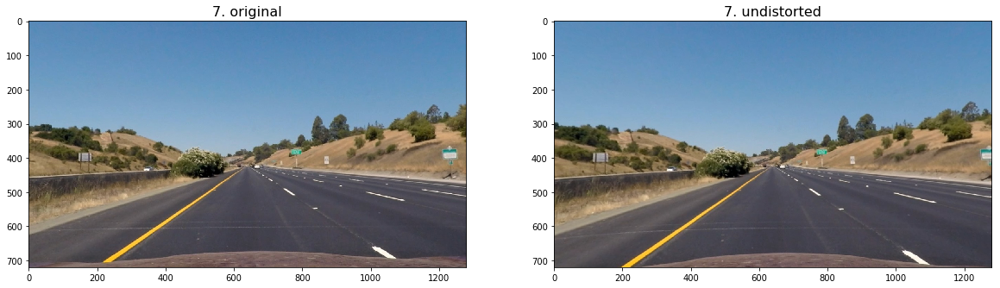

In [11]:
undistorted = undistort(test_images[-1], mtx, dist)
visualize(7, (test_images[-1], 'original', None), (undistorted, 'undistorted', None))

# Now do perspective warping

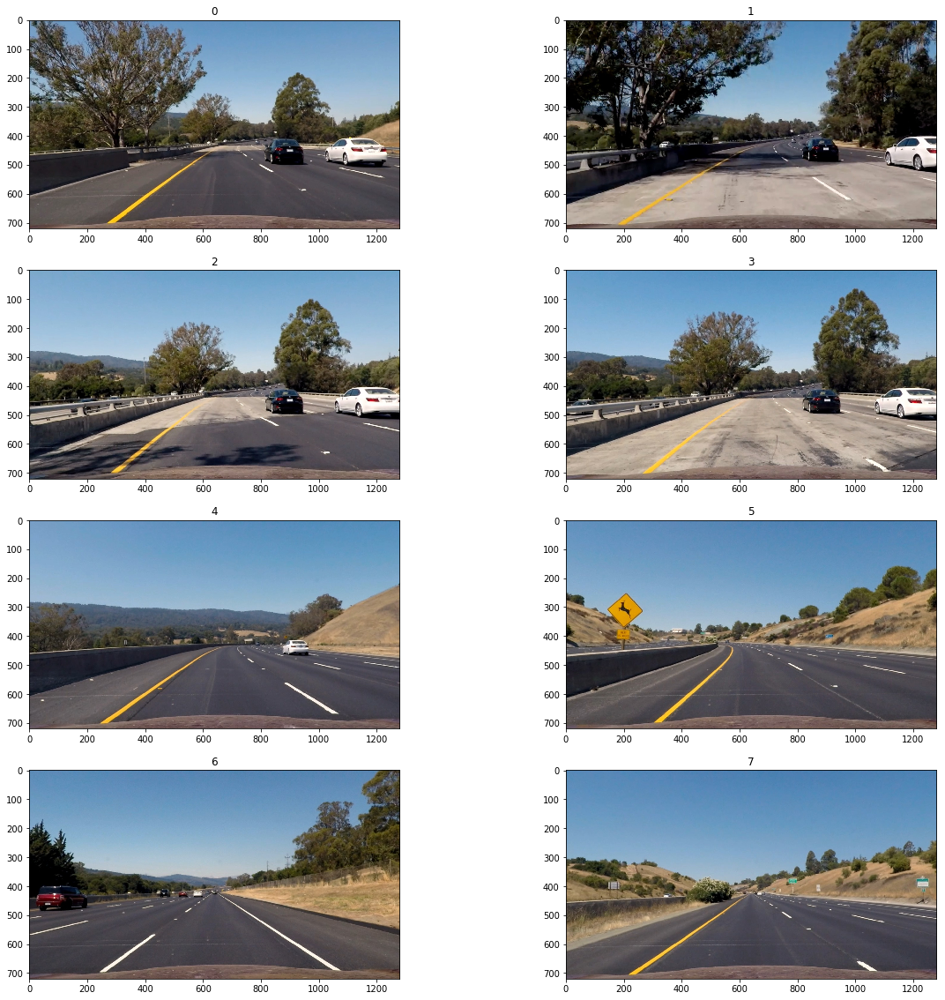

In [12]:
visualize_many_images(test_images, ncols=2)

### use last image because it looks straight

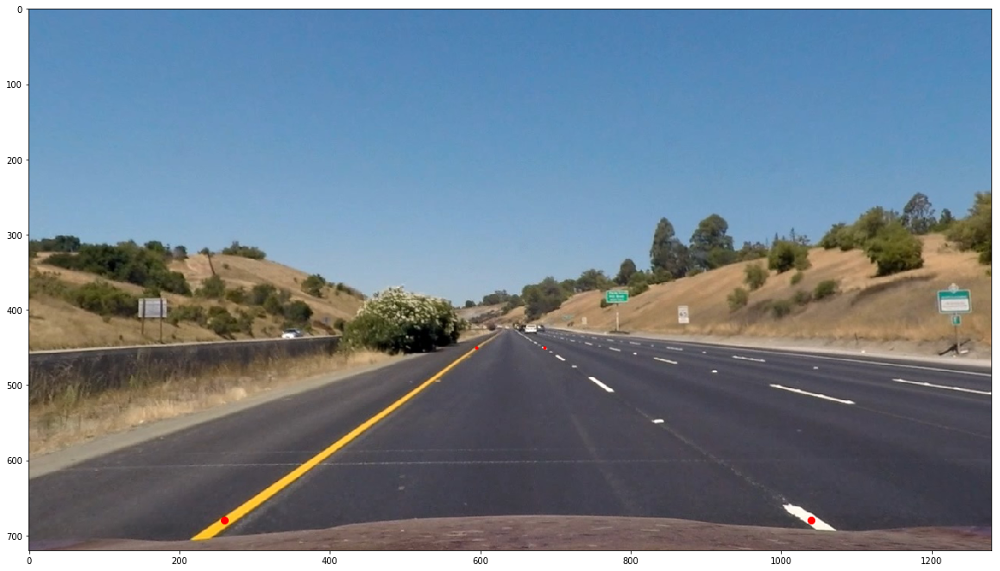

In [13]:
plt.figure(figsize=(20,20))
plt.imshow(test_images[-1])
plt.plot(260,680, 'r.', markersize=16)
plt.plot(1040,680, 'r.', markersize=16)
plt.plot(595,450, 'r.', markersize=6)
plt.plot(685,450, 'r.', markersize=6)

In [14]:
src = np.float32([
  [260,680], # bottom left
  [1040,680], # bottom right
  [595,450],
  [685,450]
])

dest = np.float32([
  [260,720],
  [1040,720],
  [260,0],
  [1040,0]
])

warp_matrix = cv2.getPerspectiveTransform(src, dest)
Minv = cv2.getPerspectiveTransform(dest, src)

In [15]:
def warp_image(img, warp_matrix, interpolation=cv2.INTER_LINEAR):
  return cv2.warpPerspective(img, warp_matrix, img.shape[:2][::-1], flags=interpolation)

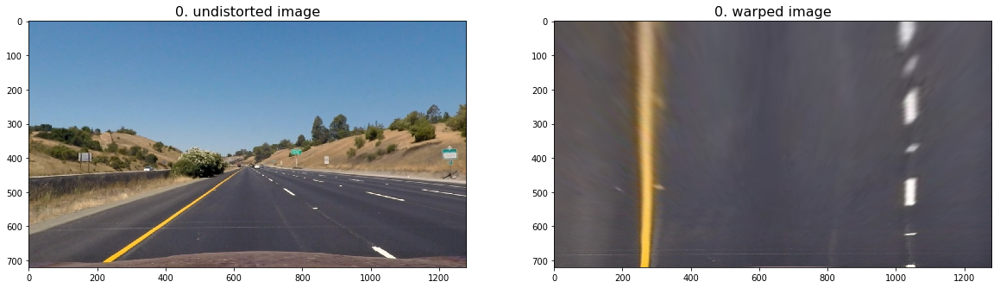

In [16]:
warped = warp_image(test_images[-1], warp_matrix)
visualize(
  0, 
  (test_images[-1], 'undistorted image', None), 
  (warped, 'warped image', None)
)

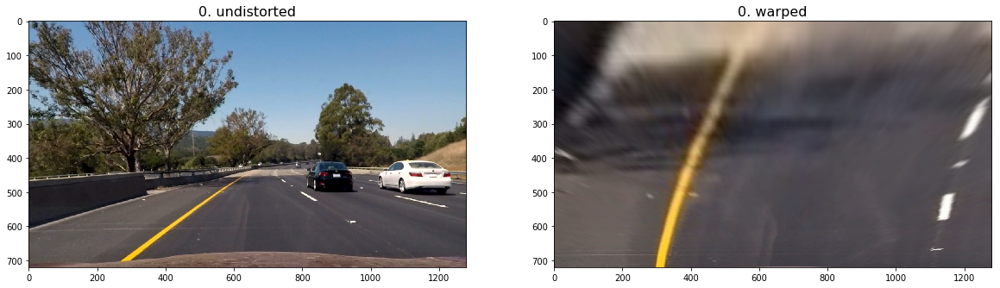

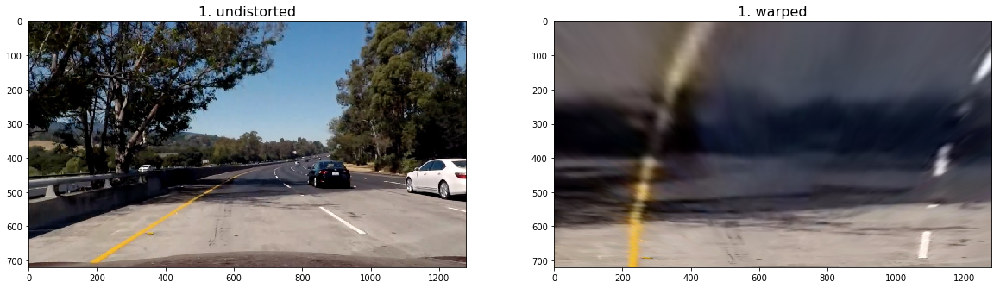

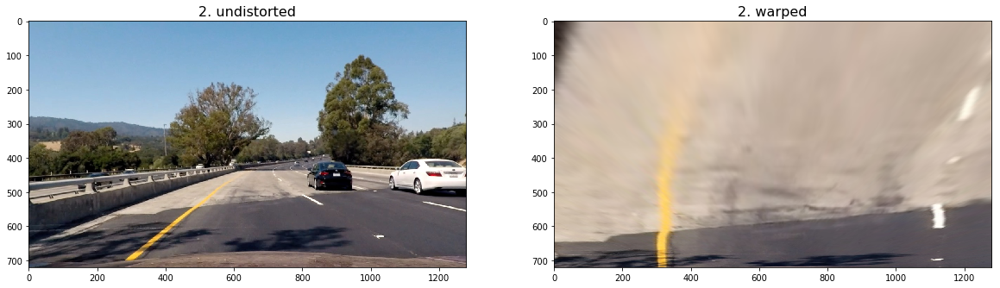

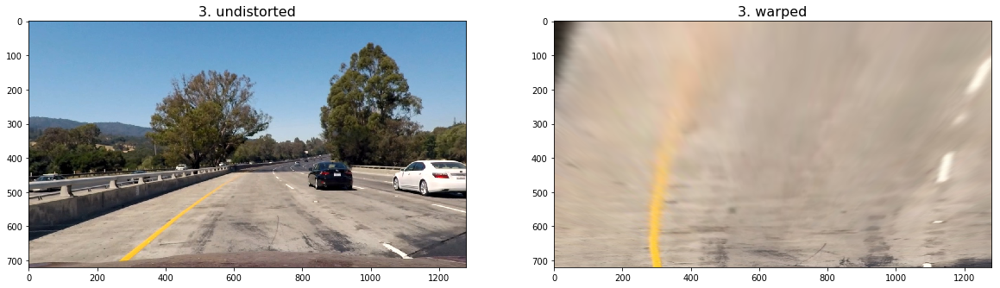

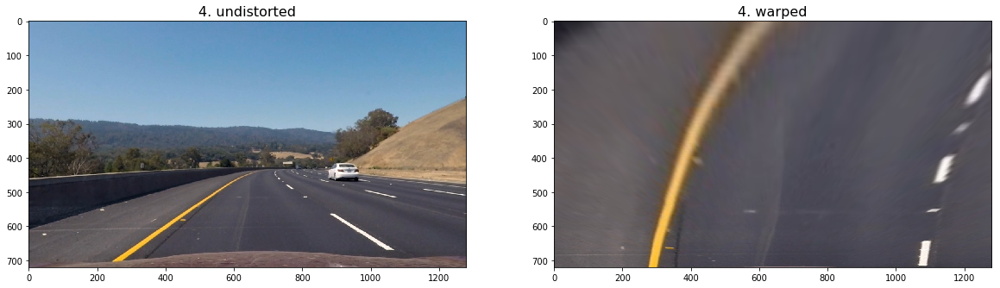

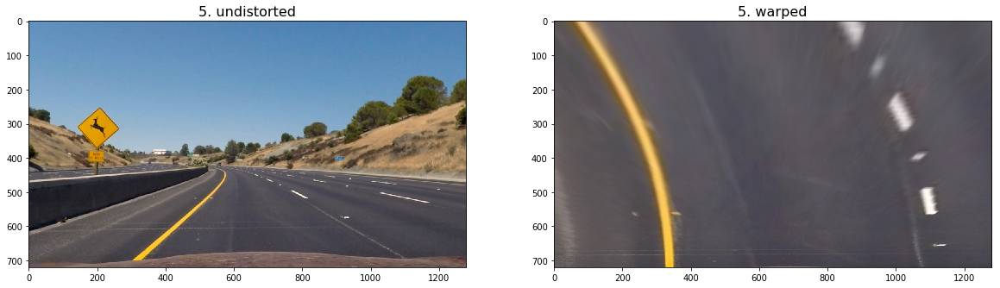

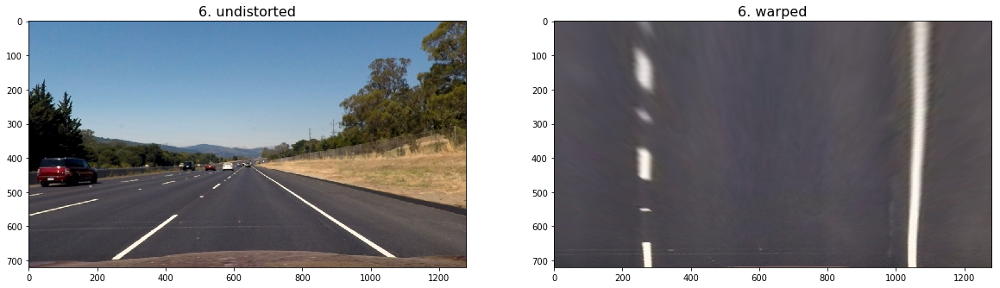

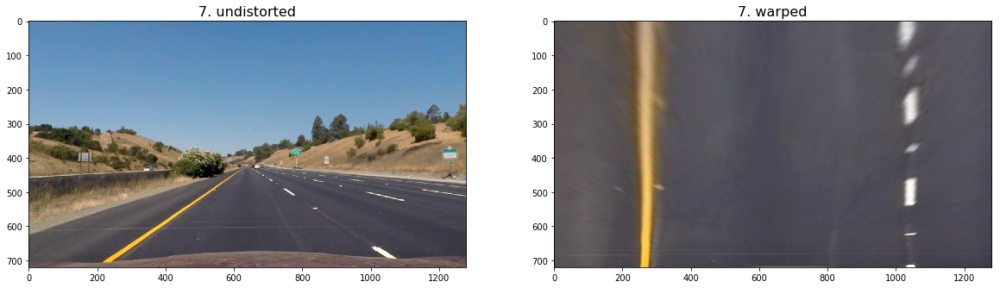

In [17]:
for i, img in enumerate(test_images):
  warped = warp_image(img, warp_matrix)
  visualize(i, (img, 'undistorted', None), (warped, 'warped', None))

In [18]:
def filter_colors_hsv(img):
  """
  Convert image to HSV color space and suppress any colors
  outside of the defined color ranges
  """
  img = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
  yellow_dark = np.array([15, 127, 127], dtype=np.uint8)
  yellow_light = np.array([25, 255, 255], dtype=np.uint8)
  yellow_range = cv2.inRange(img, yellow_dark, yellow_light)

  white_dark = np.array([0, 0, 200], dtype=np.uint8)
  white_light = np.array([255, 30, 255], dtype=np.uint8)
  white_range = cv2.inRange(img, white_dark, white_light)
  yellows_or_whites = yellow_range | white_range
  img = cv2.bitwise_and(img, img, mask=yellows_or_whites)
  
  return img

In [19]:
def s_channel(img):
  hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
  return hls[:,:,2]

In [20]:
def grayscale(img):
  return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

def binarize(img, lower=0, upper=255):
  binary_output = np.zeros_like(img)
  binary_output[ (img > lower) & (img <= upper) ] = 1
  return binary_output

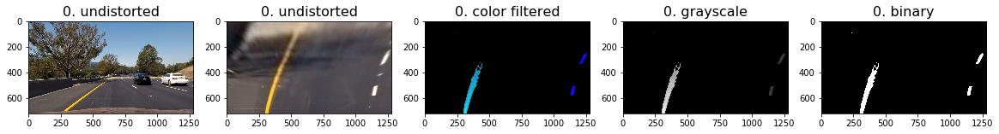

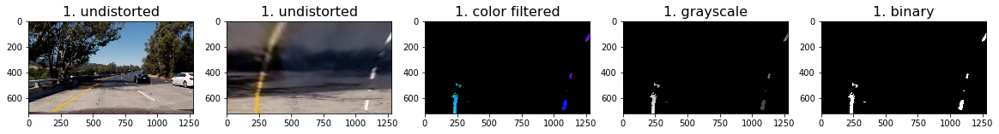

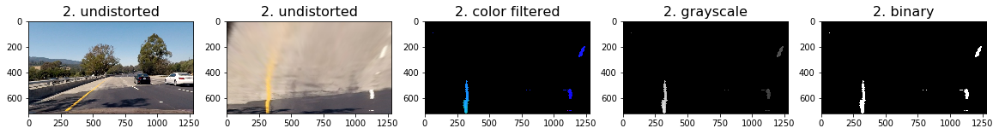

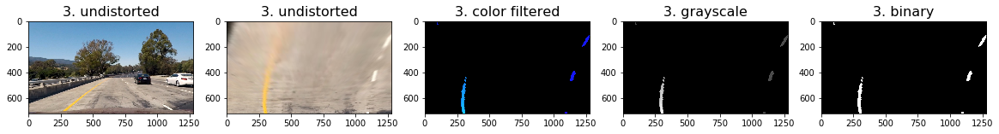

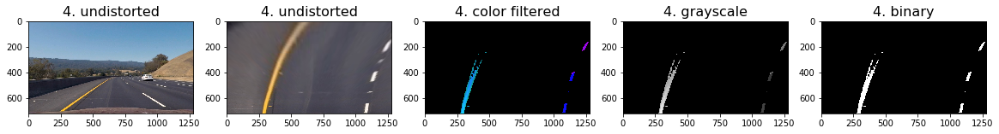

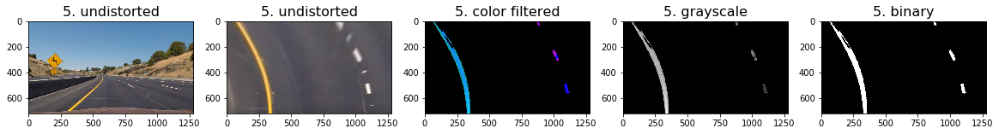

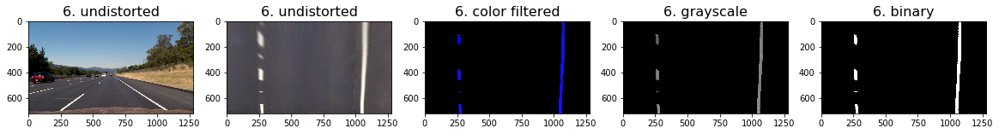

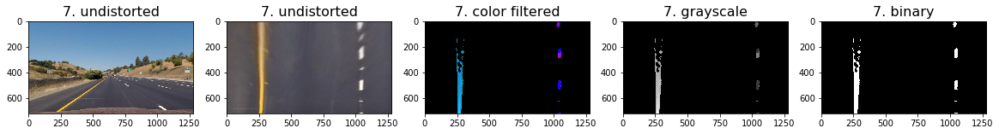

In [21]:
for i, img in enumerate(test_images):
  warped = warp_image(img, warp_matrix)
  filtered = filter_colors_hsv(warped)
  grayed = grayscale(filtered)
  binarized = binarize(grayed)

  visualize(
    i, 
    (img, 'undistorted', None),
    (warped, 'undistorted', None),
    (filtered, 'color filtered', None),
    (grayed, 'grayscale', 'gray'),
    (binarized, 'binary', 'gray')
  )
# end for

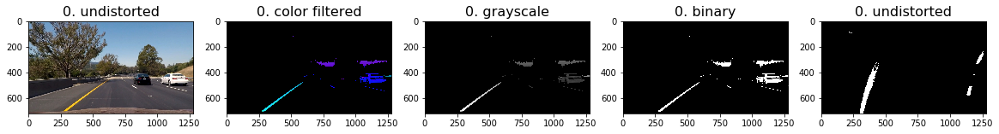

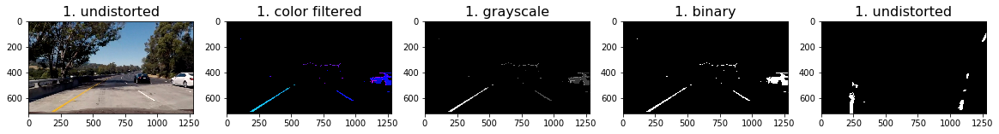

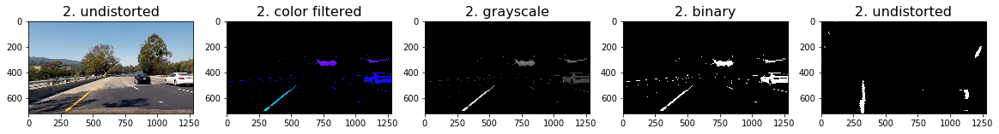

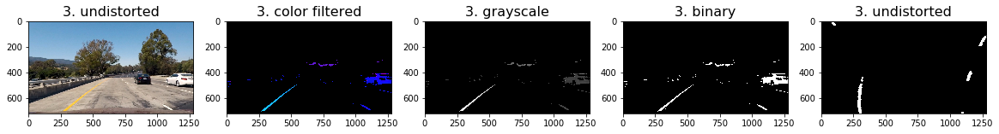

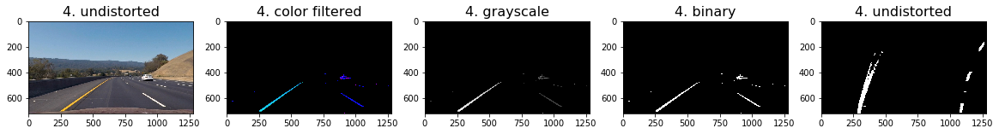

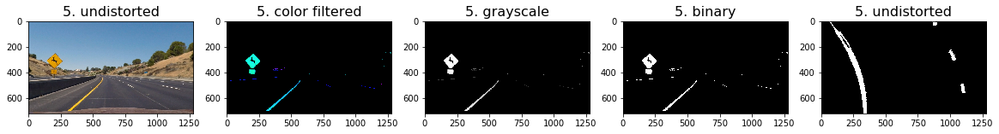

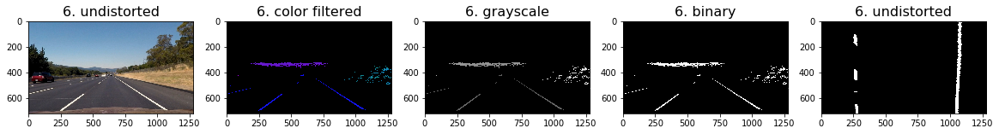

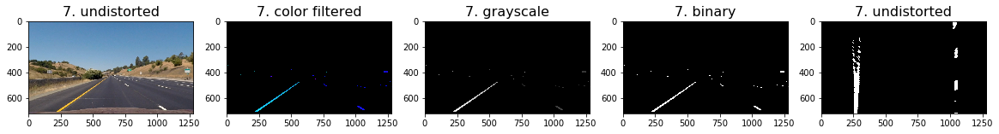

In [22]:
for i, img in enumerate(test_images):
  filtered = filter_colors_hsv(img)
  grayed = grayscale(filtered)
  binarized = binarize(grayed)
  warped = warp_image(binarized, warp_matrix)

  visualize(
    i, 
    (img, 'undistorted', None),
    (filtered, 'color filtered', None),
    (grayed, 'grayscale', 'gray'),
    (binarized, 'binary', 'gray'),
    (warped, 'undistorted', 'gray')
  )
# end for

# now explore the use of sobel filters

In [23]:
def sobel_filter(img, sobel_kernel=3, orient='x', thresholds=[0, 255]):
  # Apply x or y gradient with the OpenCV Sobel() function
  # and take the absolute value
  
  if orient == 'x':
    abs_sobel = np.abs(cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
  elif orient == 'y':
    abs_sobel = np.abs(cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
  
  # Rescale back to 8 bit integer
  scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))
  # Create a copy and apply the threshold
  binary_output = np.zeros_like(scaled_sobel)
  # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
  binary_output[(scaled_sobel >= thresholds[0]) & (scaled_sobel <= thresholds[1])] = 1

  # Return the result
  return scaled_sobel, binary_output

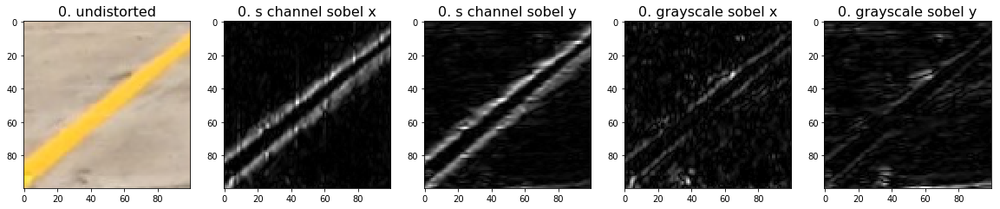

In [24]:
# focus on the area of the lane line [550:650,350:450]

img = test_images[3]
s = s_channel(img)
s_sobelx, _ = sobel_filter(s, orient='x')
s_sobely, _ = sobel_filter(s, orient='y')

grayed = grayscale(img)
grayed_sobelx, _ = sobel_filter(grayed, orient='x')
grayed_sobely, _ = sobel_filter(grayed, orient='y')

visualize(
  0,
  (img[550:650,350:450], 'undistorted', None),
  (s_sobelx[550:650,350:450], 's channel sobel x', 'gray'),
  (s_sobely[550:650,350:450], 's channel sobel y', 'gray'),
  (grayed_sobelx[550:650,350:450], 'grayscale sobel x', 'gray'),
  (grayed_sobely[550:650,350:450], 'grayscale sobel y', 'gray')
)

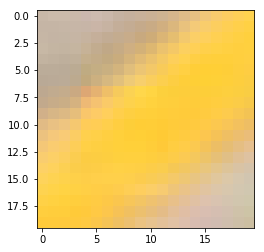

In [25]:
plt.imshow(img[590:610,390:410])

In [26]:
s_sobelx[590:610,390:410]

array([[ 2,  2,  0,  6,  0,  5,  2,  7, 14, 18, 24, 34, 45, 54, 60, 56,
        37, 20, 12,  4],
       [ 0,  0,  2,  1,  5,  5,  5, 13, 18, 23, 34, 45, 59, 66, 51, 32,
        18,  9,  4,  0],
       [ 2,  2,  4, 10,  9,  5, 10, 22, 25, 30, 47, 56, 62, 59, 33, 13,
         5,  2,  0,  0],
       [ 4,  3,  5, 18, 15,  5, 16, 33, 39, 43, 57, 60, 51, 34, 13,  3,
         0,  0,  0,  0],
       [ 3,  2,  5, 26, 24, 10, 23, 43, 55, 56, 54, 52, 35, 12,  2,  0,
         0,  0,  0,  1],
       [ 0,  0,  7, 32, 34, 22, 35, 55, 66, 56, 38, 33, 20,  3,  0,  0,
         1,  2,  2,  6],
       [ 6,  5, 15, 44, 49, 38, 47, 56, 58, 39, 16, 11,  9,  2,  0,  0,
         0,  3,  6, 15],
       [16, 14, 27, 70, 71, 45, 45, 37, 33, 18,  0,  2,  3,  2,  0,  0,
         1,  5, 11, 25],
       [24, 22, 37, 91, 83, 37, 27, 13, 11,  6,  3,  3,  2,  0,  0,  1,
         4, 11, 18, 36],
       [35, 30, 43, 85, 68, 20,  9,  0,  2,  4,  0,  0,  0,  0,  0,  1,
         9, 19, 25, 42],
       [48, 39, 39, 57, 38,  6

In [27]:
s_sobely[590:610,390:410]

array([[  4,   6,   5,   1,   6,  11,  12,  13,  17,  22,  30,  40,  53,
         71,  79,  66,  43,  27,  15,   6],
       [  1,   3,   3,   1,   8,  10,  13,  19,  25,  28,  36,  48,  59,
         67,  63,  45,  25,  11,   4,   0],
       [  4,   2,   1,   6,  12,  14,  17,  26,  36,  46,  58,  70,  73,
         61,  40,  21,  10,   3,   0,   0],
       [  0,   0,   0,   3,  11,  16,  19,  27,  42,  59,  71,  72,  63,
         40,  17,   4,   0,   0,   0,   0],
       [  8,   6,   5,   1,   7,  15,  23,  33,  46,  58,  56,  43,  28,
         12,   2,   0,   0,   2,   3,   4],
       [  5,   2,   0,   4,  12,  25,  41,  54,  63,  60,  45,  24,   6,
          2,   3,   3,   3,   3,   6,  12],
       [ 13,  22,  32,  48,  69,  86,  98,  98,  83,  61,  37,  14,   0,
          5,   5,   5,   4,   4,   7,  14],
       [ 28,  38,  49,  71,  98, 110, 103,  82,  53,  29,  15,   7,   3,
          2,   1,   2,   1,   1,   6,  14],
       [ 47,  54,  61,  70,  75,  68,  49,  28,  11,   2,   2,  

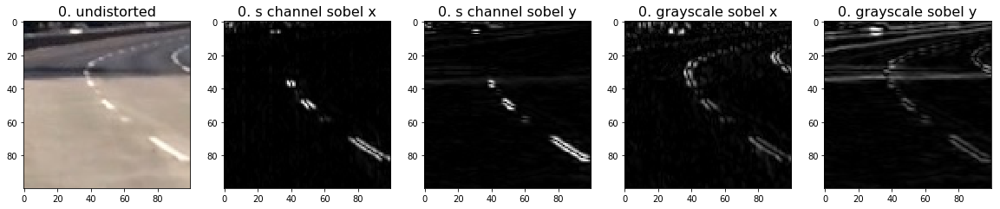

In [28]:
# focus on the area of the lane line [408:508,676:776]

img = test_images[3]
s = s_channel(img)
s_sobelx, _ = sobel_filter(s, orient='x')
s_sobely, _ = sobel_filter(s, orient='y')

grayed = grayscale(img)
grayed_sobelx, _ = sobel_filter(grayed, orient='x')
grayed_sobely, _ = sobel_filter(grayed, orient='y')

visualize(
  0,
  (img[408:508,676:776], 'undistorted', None),
  (s_sobelx[408:508,676:776], 's channel sobel x', 'gray'),
  (s_sobely[408:508,676:776], 's channel sobel y', 'gray'),
  (grayed_sobelx[408:508,676:776], 'grayscale sobel x', 'gray'),
  (grayed_sobely[408:508,676:776], 'grayscale sobel y', 'gray')
)

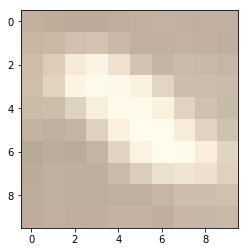

In [29]:
plt.imshow(img[453:463,721:731])

In [30]:
s_sobelx[453:463,721:731]

array([[  1,   3,   2,   3,   2,   2,   2,   1,   0,   0],
       [  7,  25,  23,  15,  35,  22,   2,   0,   2,   1],
       [ 22,  87,  85,  16,  76,  74,  35,   6,   2,   0],
       [ 23,  99, 132,  47,  44, 102, 107,  52,   7,   0],
       [  8,  42, 108, 132,  63,  45, 137, 126,  42,   7],
       [  1,   3,  46, 128, 149,  59,  81, 142, 100,  44],
       [  1,   1,   8,  58, 137, 112,   3,  77, 112,  81],
       [  1,   0,   2,  12,  56,  71,  30,   9,  55,  59],
       [  0,   0,   2,   2,   7,  15,  18,   8,   6,  11],
       [  0,   1,   0,   1,   0,   0,   5,   4,   2,   3]], dtype=uint8)

In [31]:
s_sobely[453:463,721:731]

array([[  2,   5,  10,  11,   4,   3,   3,   1,   1,   3],
       [  8,  44,  94, 106,  68,  23,   4,   4,   4,   3],
       [  7,  48, 120, 168, 164, 116,  50,  11,   4,   6],
       [  9,  37,  50,  12, 113, 165, 131,  52,   7,   0],
       [ 21,  64, 132, 134,  42,  70, 131, 106,  43,   6],
       [ 14,  19,  52, 115, 125,  47,  51, 115, 105,  46],
       [  0,   0,   8,  53, 126, 163, 130,  50,  13,  23],
       [  4,   5,   4,   7,  60, 145, 187, 166, 106,  37],
       [  1,   2,   3,   4,   2,  23,  49,  64,  55,  28],
       [  1,   1,   0,   2,   2,   1,   0,   2,   6,  10]], dtype=uint8)

In [32]:
def mag_thresh(sobelx, sobely, sobel_kernel=3, mag_thresholds=[0, 255]):
  # Calculate the gradient magnitude
  gradmag = np.sqrt(sobelx**2 + sobely**2)
  # Rescale to 8 bit
  scale_factor = np.max(gradmag)/255 
  
  gradmag = (gradmag/scale_factor).astype(np.uint8)
  # Create a binary image of ones where threshold is met, zeros otherwise
  binary_output = np.zeros_like(gradmag)
  binary_output[(gradmag >= mag_thresholds[0]) & (gradmag <= mag_thresholds[1])] = 1

  # Return the binary image
  return gradmag, binary_output

In [33]:
def dir_threshold(sobelx, sobely, sobel_kernel=15, thresholds=[0, np.pi/2]):  
  # Take the absolute value of the gradient direction, 
  # apply a threshold, and create a binary image result
  absgraddir = np.arctan2(np.abs(sobely), np.abs(sobelx))
  binary_output =  np.zeros_like(absgraddir)
  binary_output[(absgraddir >= thresholds[0]) & (absgraddir <= thresholds[1])] = 1

  # Return the binary image
  return absgraddir, binary_output

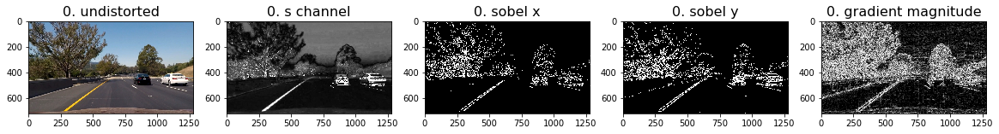

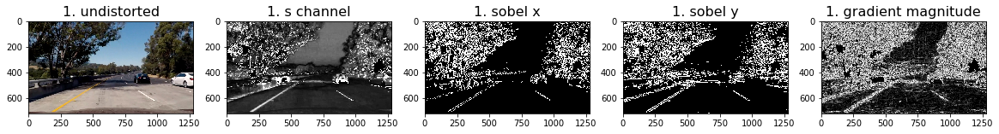

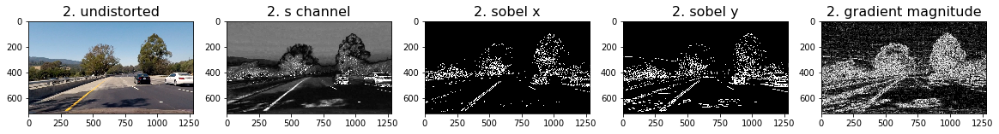

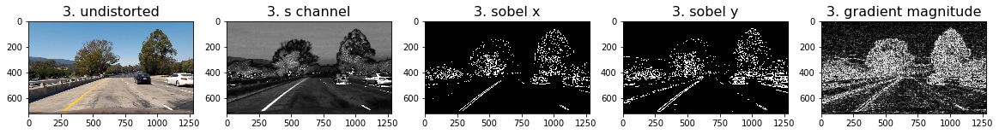

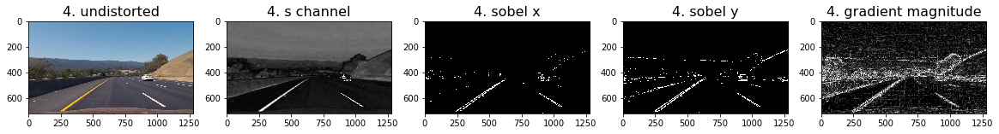

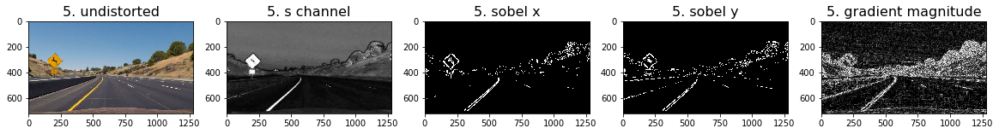

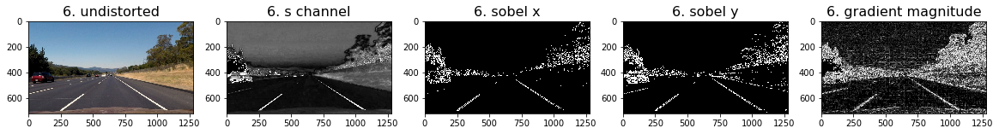

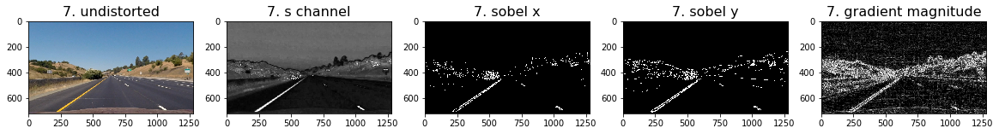

In [34]:
for i, img in enumerate(test_images):
  s      = s_channel(img)
  sobelx, binary_output_x = sobel_filter(s, orient='x', thresholds=[20,255])
  sobely, binary_output_y = sobel_filter(s, orient='y', thresholds=[20,255])
  gradmag, binary_output_mag = mag_thresh(sobelx, sobely, mag_thresholds=[0, 255])
  
  visualize(
    i,
    (img, 'undistorted', None),
    (s, 's channel', 'gray'),
    (binary_output_x, 'sobel x', 'gray'),
    (binary_output_y, 'sobel y', 'gray'),
    (gradmag, 'gradient magnitude', 'gray'),
  )
# end for

### apply sobel filter then warp

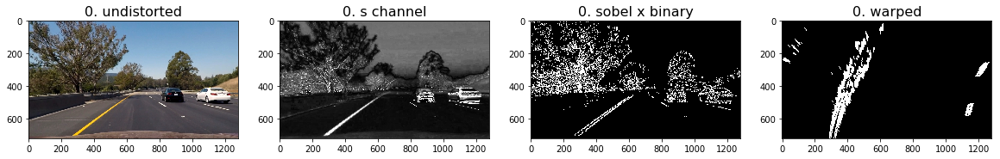

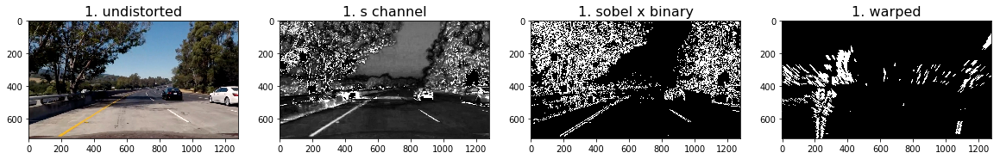

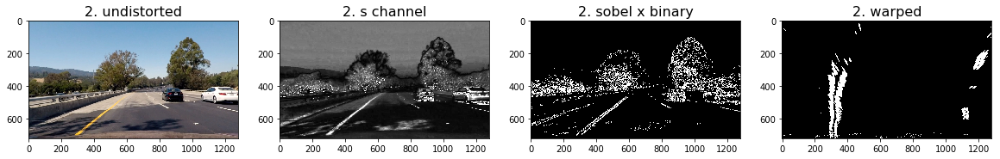

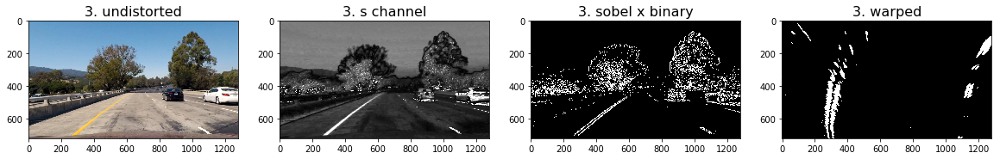

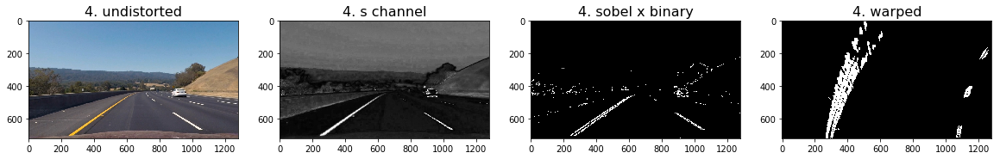

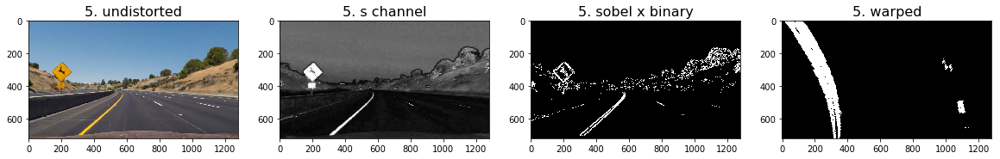

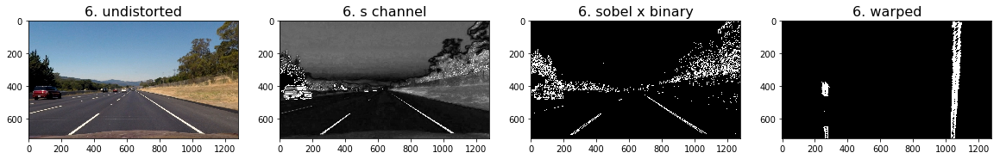

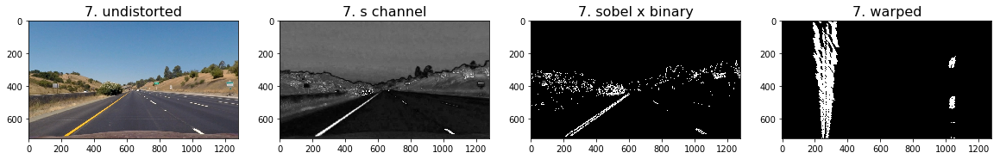

In [35]:
for i, img in enumerate(test_images):
  s       = s_channel(img)
  sobelx, binary_output_x = sobel_filter(s, orient='x', thresholds=[15,255])
  warped  = warp_image(binary_output_x, warp_matrix)

  visualize(
    i, 
    (img, 'undistorted', None),
    (s, 's channel', 'gray'),
    (binary_output_x, 'sobel x binary', 'gray'),
    (warped, 'warped', 'gray')
  )

# warp first then apply sobel filter

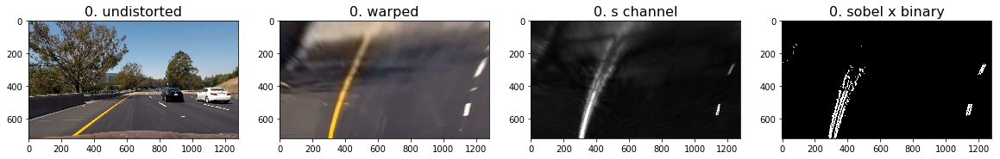

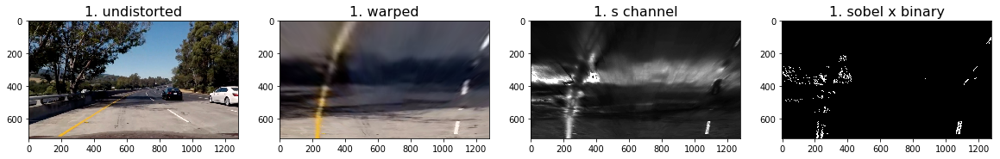

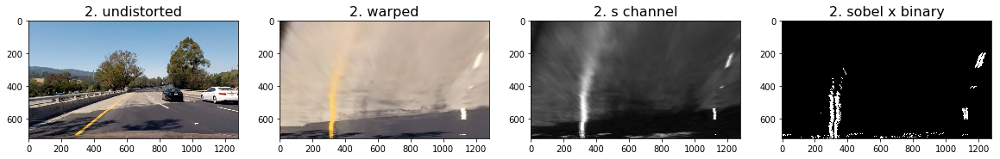

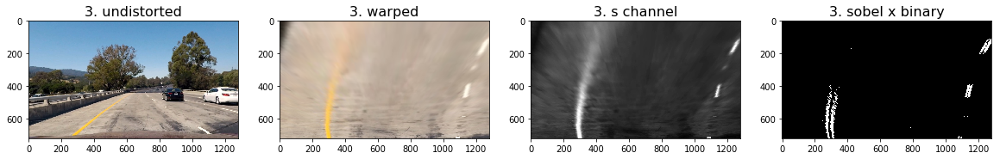

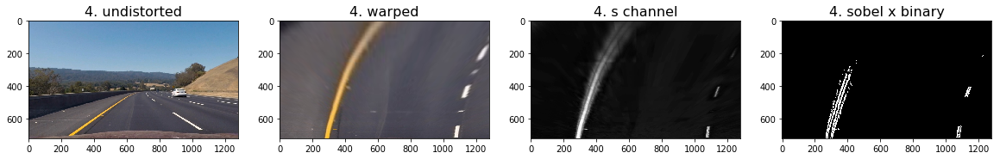

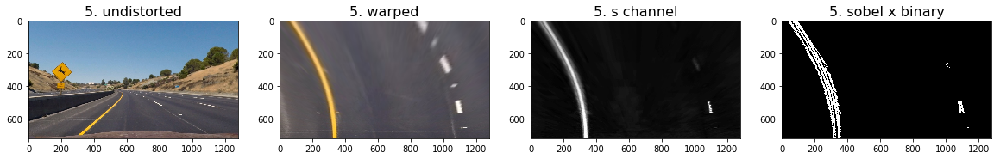

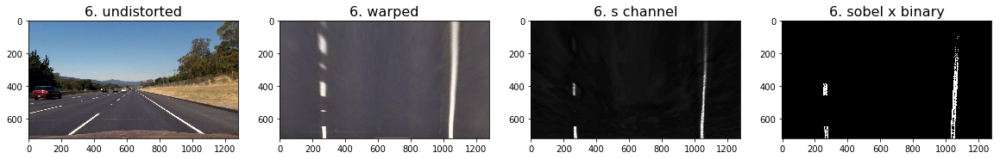

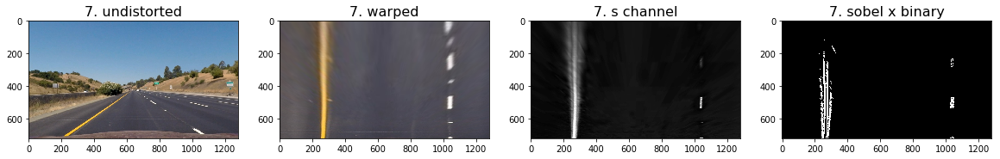

In [36]:
for i, img in enumerate(test_images):
  warped = warp_image(img, warp_matrix)
  s      = s_channel(warped)
  sobelx, binary_output_x = sobel_filter(s, orient='x', thresholds=[15,255])

  visualize(
    i, 
    (img, 'undistorted', None),
    (warped, 'warped', None),
    (s, 's channel', 'gray'),
    (binary_output_x, 'sobel x binary', 'gray'),
  )

# combine color thresholding and sobel x

In [37]:
def combine_color_sobelx(img):
  filtered = filter_colors_hsv(img)
  grayed = grayscale(filtered)
  binarized = binarize(grayed)
  s       = s_channel(img)
  sobelx, binary_output_x = sobel_filter(s, orient='x', thresholds=[15,255])
  binary_output = binarized | binary_output_x
  return binary_output

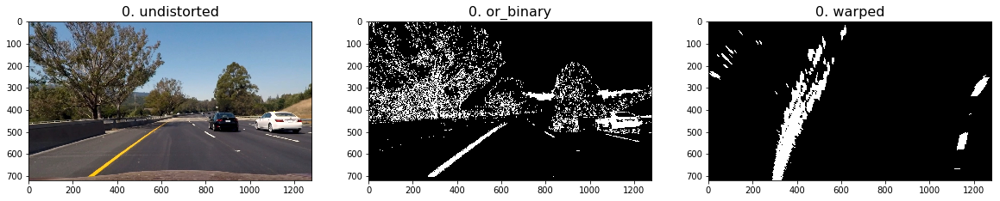

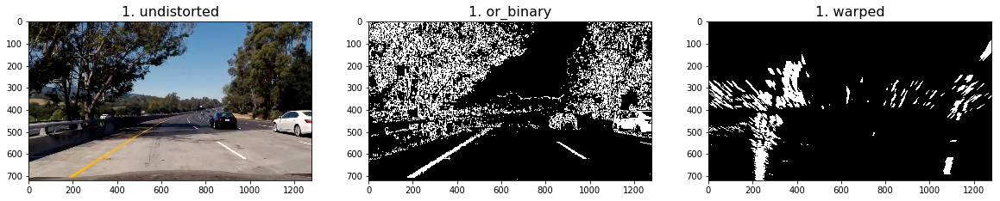

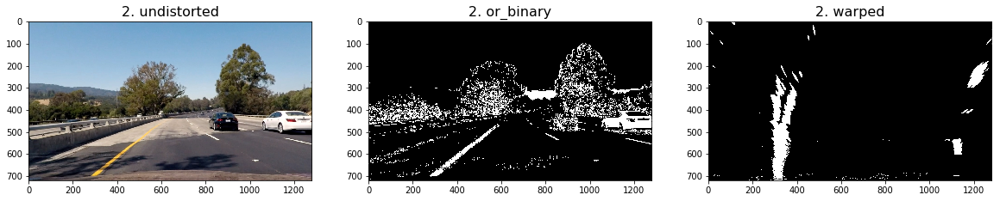

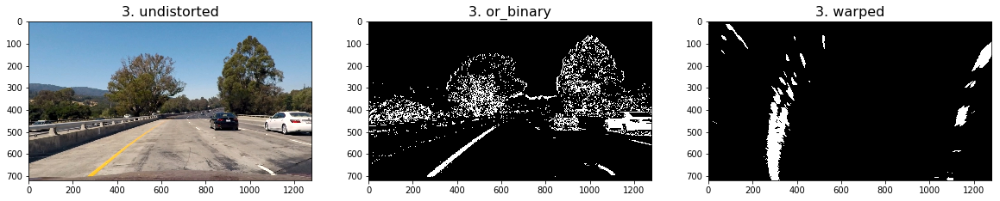

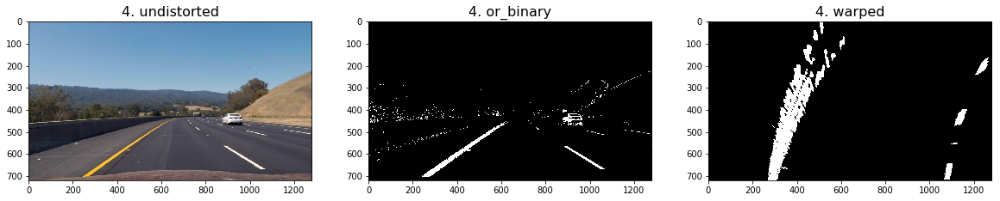

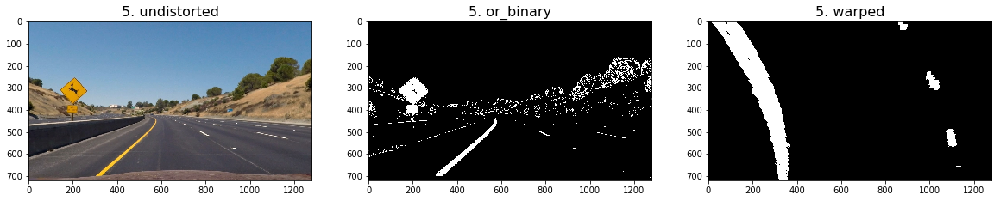

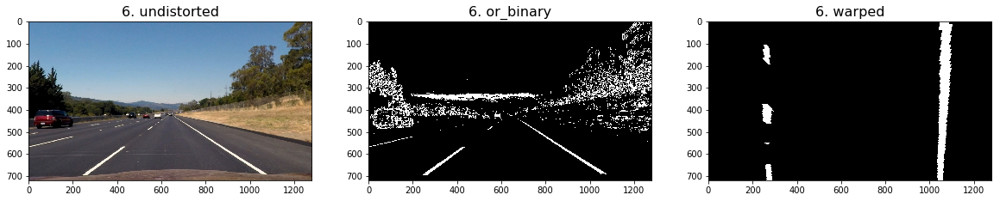

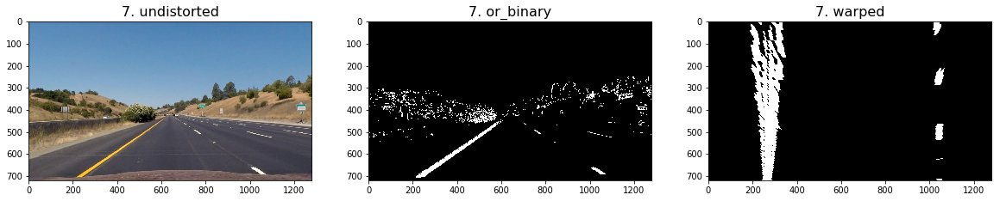

In [38]:
for i, img in enumerate(test_images):
  binary_output = combine_color_sobelx(img)
  warped = warp_image(binary_output, warp_matrix)
  
  visualize(
    i, 
    (img, 'undistorted', None),
    (binary_output, 'or_binary', 'gray'),
    (warped, 'warped', 'gray')
  )

In [39]:
def sliding_window(binary_warped, nwindows=9):
  # Assuming you have created a warped binary image called "binary_warped"
  
  # Take a histogram of the bottom half of the image
  histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
  
  # Create an output image to draw on and  visualize the result
  out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
  
  # Find the peak of the left and right halves of the histogram
  
  # These will be the starting point for the left and right lines
  midpoint = np.int(histogram.shape[0]//2)
  leftx_base = np.argmax(histogram[:midpoint])
  rightx_base = np.argmax(histogram[midpoint:]) + midpoint

  # Set height of windows
  window_height = np.int(binary_warped.shape[0] // nwindows) # 720 / 9 = 80
  
  # Identify the x and y positions of all nonzero pixels in the image
  nonzero = binary_warped.nonzero() # obtain the (row,col) sparse representation of this (possibly) sparse matrix
  nonzeroy = np.array(nonzero[0])
  nonzerox = np.array(nonzero[1])
  
  # Current positions to be updated for each window
  leftx_current = leftx_base
  rightx_current = rightx_base
  
  # Set the width of the windows +/- margin
  margin = 100
  
  # Set minimum number of pixels found to recenter window
  minpix = 50
  
  # Create empty lists to receive left and right lane pixel indices
  left_lane_inds = []
  right_lane_inds = []

  # Step through the windows one by one
  for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_warped.shape[0] - (window + 1) * window_height # 720 - 80 = 640
    win_y_high = binary_warped.shape[0] - window * window_height # 720 
    
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
    (0,255,0), 10) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
    (0,255,0), 10) 
    
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = (
      (nonzeroy >= win_y_low) & 
      (nonzeroy < win_y_high) & 
      (nonzerox >= win_xleft_low) & 
      (nonzerox < win_xleft_high)
    ).nonzero()[0]
    

    good_right_inds = (
      (nonzeroy >= win_y_low) & 
      (nonzeroy < win_y_high) & 
      (nonzerox >= win_xright_low) & 
      (nonzerox < win_xright_high)
    ).nonzero()[0]

    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)

    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
  # endfor
  
  # Concatenate the arrays of indices
  left_lane_inds = np.concatenate(left_lane_inds)
  right_lane_inds = np.concatenate(right_lane_inds)

  # Extract left and right line pixel positions
  leftx = nonzerox[left_lane_inds]
  lefty = nonzeroy[left_lane_inds]
  rightx = nonzerox[right_lane_inds]
  righty = nonzeroy[right_lane_inds]

  # Fit a second order polynomial to each
  left_fit = np.polyfit(lefty, leftx, 2)
  right_fit = np.polyfit(righty, rightx, 2)
  
  ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
  left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
  right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

  # color lines
  out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
  out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

  return out_img, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx, lefty, righty

# Apply Sliding Window to find lane lines

In [40]:
def visualize_sliding_window(out_img, left_fitx, right_fitx, ploty):
  plt.imshow(out_img)
  plt.plot(left_fitx, ploty, color='yellow')
  plt.plot(right_fitx, ploty, color='yellow')
  plt.xlim(0, 1280)
  plt.ylim(720, 0)

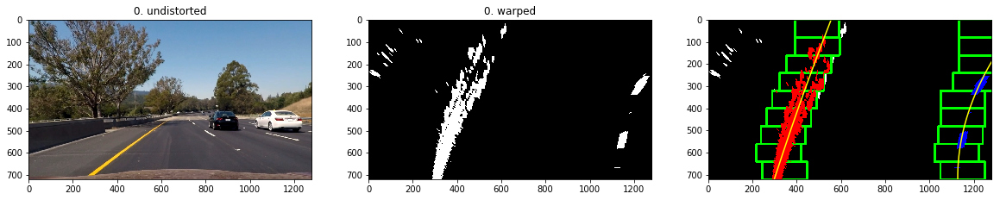

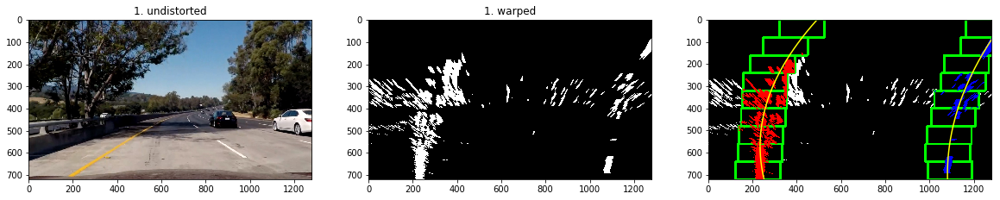

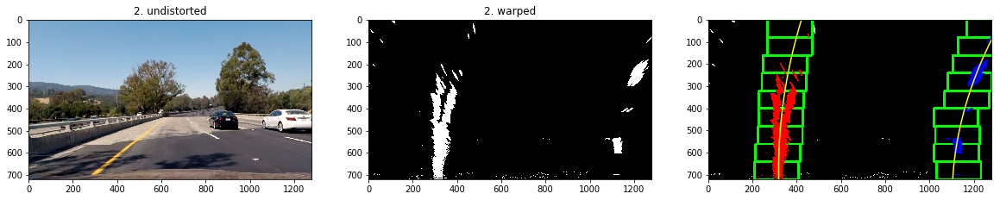

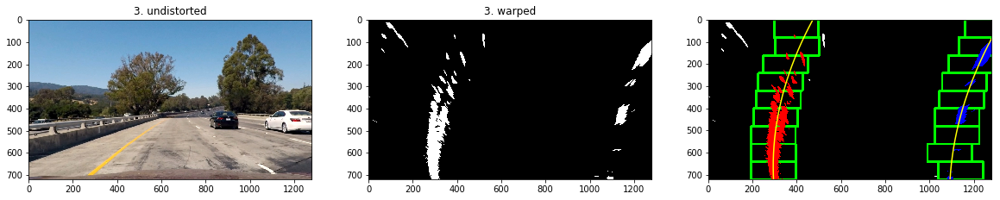

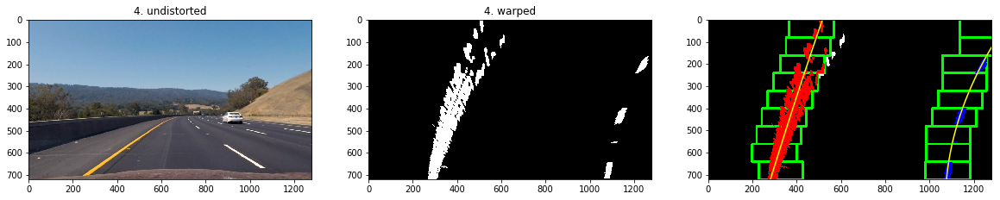

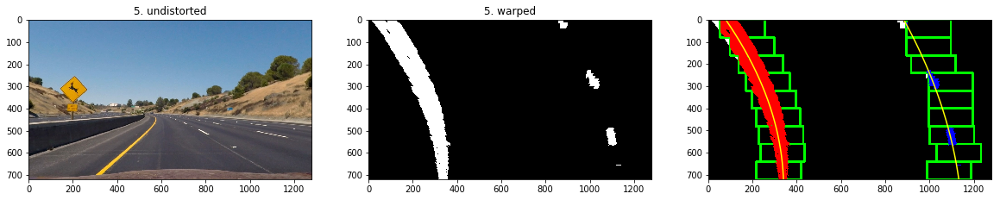

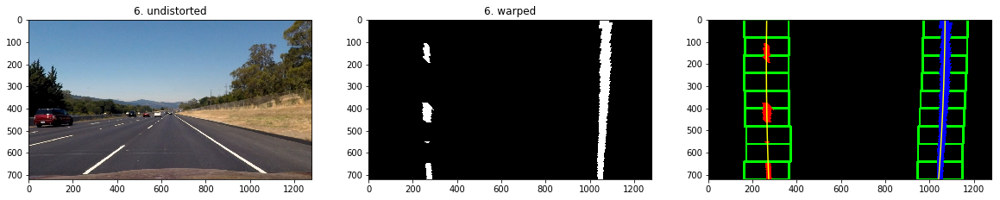

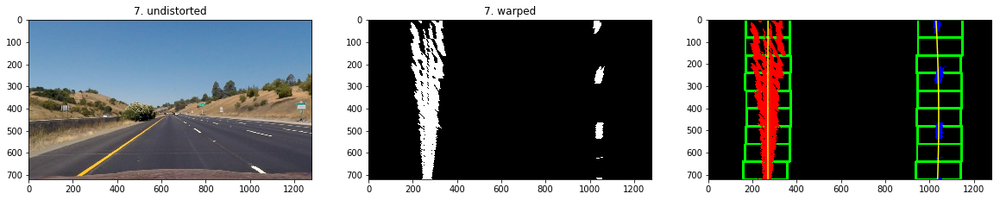

In [41]:
for i, img in enumerate(test_images):
  binary_output = combine_color_sobelx(img)
  warped = warp_image(binary_output, warp_matrix)
  
  out_img, left_fitx, right_fitx, ploty, _, _, _, _, _, _ = sliding_window(warped)
  
  plt.figure(figsize=(20,20))
  plt.subplot(1,3,1)
  plt.imshow(img)
  plt.title('{}. undistorted'.format(i))
  
  plt.subplot(1,3,2)
  plt.imshow(warped, cmap='gray')
  plt.title('{}. warped'.format(i))
  
  plt.subplot(1,3,3)
  visualize_sliding_window(out_img, left_fitx, right_fitx, ploty)
# endfor

In [42]:
def next_frame(binary_warped, left_fit, right_fit):
  # Assume you now have a new warped binary image 
  # from the next frame of video (also called "binary_warped")
  # It's now much easier to find line pixels!
  nonzero = binary_warped.nonzero() # get sparse values
  nonzeroy = np.array(nonzero[0])
  nonzerox = np.array(nonzero[1])
  margin = 100
  left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin)))

  right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))

  # Again, extract left and right line pixel positions
  leftx = nonzerox[left_lane_inds]
  lefty = nonzeroy[left_lane_inds]
  rightx = nonzerox[right_lane_inds]
  righty = nonzeroy[right_lane_inds]
  
  # Fit a second order polynomial to each
  left_fit = np.polyfit(lefty, leftx, 2)
  right_fit = np.polyfit(righty, rightx, 2)
  
  # Generate x and y values for plotting
  ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
  left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
  right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
  
  # Create an image to draw on and an image to show the selection window
  out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
  window_img = np.zeros_like(out_img)
  
  # Color in left and right line pixels
  out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
  out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
  
  # Generate a polygon to illustrate the search window area
  # And recast the x and y points into usable format for cv2.fillPoly()
  left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
  left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])

  left_line_pts = np.hstack((left_line_window1, left_line_window2))
  right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
  right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
  right_line_pts = np.hstack((right_line_window1, right_line_window2))

  # Draw the lane onto the warped blank image
  cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
  cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
  result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

  return result, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx, lefty, righty

In [43]:
img = test_images[-3]
binary_output = combine_color_sobelx(img)
warped = warp_image(binary_output, warp_matrix)
  
out_img, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx, lefty, righty = sliding_window(warped)

In [44]:
result, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx, lefty, righty = next_frame(warped, left_fit, right_fit)

(720, 0)

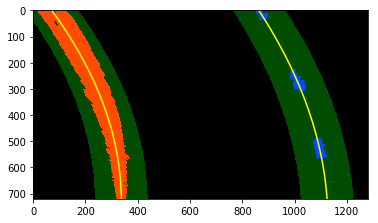

In [45]:
plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

# Draw the lane in green

In [46]:
def draw_green(img, warped, left_fitx, right_fitx, ploty, Minv):
  # Create an image to draw the lines on
  warp_zero = np.zeros_like(warped).astype(np.uint8)
  color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

  # Recast the x and y points into usable format for cv2.fillPoly()
  pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
  pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
  pts = np.hstack((pts_left, pts_right))

  # Draw the lane onto the warped blank image
  cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

  # Warp the blank back to original image space using inverse perspective matrix (Minv)
  newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
  # Combine the result with the original image
  result = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
  return result

In [47]:
result = draw_green(img, warped, left_fitx, right_fitx, ploty, Minv)

In [48]:
(left_fitx[-1] + right_fitx[-1]) / 2.0

730.6384303272504

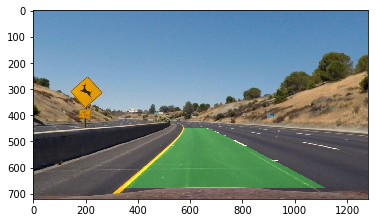

In [49]:
plt.imshow(result)

In [50]:
def get_radius_of_curvature(leftx, rightx, lefty, righty, y_eval):
  # Define conversions in x and y from pixels space to meters
  ym_per_pix = 30 / 720 # meters per pixel in y dimension
  xm_per_pix = 3.7 / 700 # meters per pixel in x dimension

  # Fit new polynomials to x,y in world space
  left_fit_cr = np.polyfit(lefty * ym_per_pix, leftx * xm_per_pix, 2)
  right_fit_cr = np.polyfit(righty * ym_per_pix, rightx * xm_per_pix, 2)

  # Calculate the new radii of curvature
  left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
  right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

  # Now our radius of curvature is in meters
  # print(left_curverad, 'm', right_curverad, 'm')
  
  return (left_curverad + right_curverad) / 2.0

In [51]:
left_fit = None
right_fit = None
def pipeline(img):
  global left_fit
  global right_fit
  binary_output = combine_color_sobelx(img)
  warped = warp_image(binary_output, warp_matrix)
  if left_fit is None and right_fit is None:
    _, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx, lefty, righty = sliding_window(warped)
  else:
    _, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx, lefty, righty = next_frame(warped, left_fit, right_fit)
  # endif
  
  y_eval = np.max(ploty)
  
  if np.mean(left_fitx) >= np.mean(right_fitx):
    left_fit = None
    right_fit = None
  
  result = draw_green(img, warped, left_fitx, right_fitx, ploty, Minv)
  avg_radius = get_radius_of_curvature(leftx, rightx, lefty, righty, y_eval)
  
  cv2.putText(
    result, 
    'Radius of Curvature: {:.3g}(m)'.format(avg_radius), 
    (50,50), 
    cv2.FONT_HERSHEY_SIMPLEX, 
    2.0, 
    [255,255,255],
    2
  )
  
  img_center = img.shape[1] / 2.0
  lane_center = (left_fitx[-1] + right_fitx[-1]) / 2.0
  
  if img_center < lane_center:
    # vehicle is left of lane center
    text = 'Vehicle is left of center by: {:.3g}(m)'.format((lane_center - img_center) / 700)
  else: # if img_center > lane_center
    # vehicle is right of lane center
    text = 'Vehicle is right of center by: {:.3g}(m)'.format((img_center - lane_center) / 700)
    
  cv2.putText(
    result, 
    text, 
    (50,130), 
    cv2.FONT_HERSHEY_SIMPLEX, 
    2.0, 
    [255,255,255],
    2
  )
  
  return result
# end def

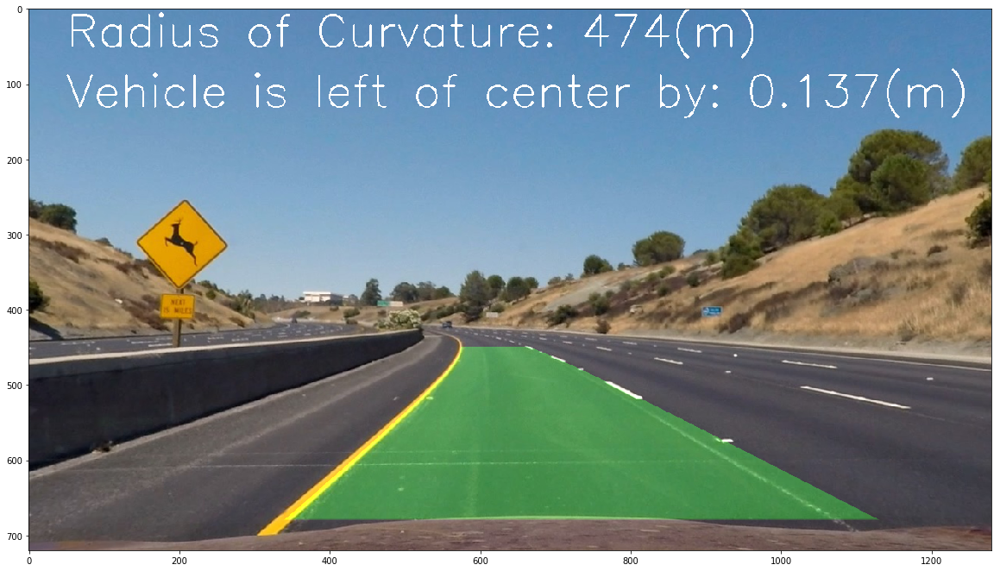

In [52]:
result = pipeline(img)
plt.figure(figsize=(20,20))
plt.imshow(result)

# Process video

In [53]:
def draw_lane_lines(movie_file_in, movie_file_out):
  clip1 = VideoFileClip(movie_file_in)
  clip_with_lane = clip1.fl_image(pipeline)
  %time clip_with_lane.write_videofile(movie_file_out, audio=False)
# end def

In [54]:
draw_lane_lines('project_video.mp4', 'project_video.lanes.mp4')

[MoviePy] >>>> Building video project_video.lanes.mp4
[MoviePy] Writing video project_video.lanes.mp4


100%|█████████▉| 1260/1261 [02:07<00:00,  8.03it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video.lanes.mp4 

CPU times: user 6min 59s, sys: 41.9 s, total: 7min 41s
Wall time: 2min 8s


In [55]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format('project_video.lanes.mp4'))